## GeoPandas

- [GeoPandas](https://geopandas.org/index.html)
- Pythonで地理空間データを簡単に操作できるPythonパッケージ
- pandasのデータ型を拡張して、形や位置などの空間データを扱える

### GeoDataFrame

- `GeoDataFrame` は `DataFrame` を拡張したデータ型
- 空間情報をもつ `GeoSeries` 型の列が含まれる

![](https://geopandas.org/_images/dataframe.svg)

> https://geopandas.org/getting_started/introduction.html#Concepts

### GeoJSON

- GISファイル形式のひとつ
- JSONを用いて空間データをエンコードし非空間属性を関連付けるファイルフォーマット
- 属性にはポイント（住所や座標）、ライン（各種道路や境界線）、 ポリゴン（国や地域）などが含まれる

> 「GeoJSON」『フリー百科事典　ウィキペディア日本語版』。2020年4月19日 (日) 04:32、URL: https://ja.wikipedia.org/wiki/GeoJSON

In [2]:
%%bash

pip install geopandas > /dev/null
wget https://nlftp.mlit.go.jp/ksj/old/data/L01/L01-2022P/L01-2022P-26-01.0a.zip > /dev/null
unzip L01-2022P-26-01.0a.zip > /dev/null
wget https://nlftp.mlit.go.jp/ksj/gml/data/N03/N03-2022/N03-20220101_26_GML.zip > /dev/null
unzip N03-20220101_26_GML.zip > /dev/null

--2022-09-10 18:19:34--  https://nlftp.mlit.go.jp/ksj/old/data/L01/L01-2022P/L01-2022P-26-01.0a.zip
nlftp.mlit.go.jp (nlftp.mlit.go.jp) をDNSに問いあわせています... 192.29.41.65, 192.29.39.51, 192.29.43.211
nlftp.mlit.go.jp (nlftp.mlit.go.jp)|192.29.41.65|:443 に接続しています... 接続しました。
HTTP による接続要求を送信しました、応答を待っています... 200 OK
長さ: 89971 (88K) [application/zip]
‘L01-2022P-26-01.0a.zip’ に保存中

     0K .......... .......... .......... .......... .......... 56% 10.6M 0s
    50K .......... .......... .......... .......              100% 69.7M=0.005s

2022-09-10 18:19:34 (16.6 MB/s) - ‘L01-2022P-26-01.0a.zip’ へ保存完了 [89971/89971]

--2022-09-10 18:19:34--  https://nlftp.mlit.go.jp/ksj/gml/data/N03/N03-2022/N03-20220101_26_GML.zip
nlftp.mlit.go.jp (nlftp.mlit.go.jp) をDNSに問いあわせています... 192.29.41.65, 192.29.39.51, 192.29.43.211
nlftp.mlit.go.jp (nlftp.mlit.go.jp)|192.29.41.65|:443 に接続しています... 接続しました。
HTTP による接続要求を送信しました、応答を待っています... 200 OK
長さ: 8026878 (7.7M) [application/zip]
‘N03-20220101_26_GML.zip’ に保存中

     0K .

GEOJSONは標準ライブラリのjsonで読み込める

In [3]:
import json

import geopandas
import numpy as np
import pandas as pd
import plotly.express as px

with open("N03-22_26_220101.geojson") as f:
    geojson = json.load(f)

geojson["features"][1]["properties"]

{'N03_001': '京都府',
 'N03_002': None,
 'N03_003': '京都市',
 'N03_004': '北区',
 'N03_007': '26101'}

geopandasによるGEOJSONファイルの読み込み

In [4]:
kyoto_gdf = geopandas.read_file("N03-22_26_220101.geojson").set_index("N03_004", drop=False).dropna(subset=["N03_004"])
kyoto_gdf.head()

,N03_001,N03_002,N03_003,N03_004,N03_007,geometry
N03_004,,,,,,
北区,京都府,None,京都市,北区,26101,"POLYGON ((135.72539 35.17080, 135.72552 35.170..."
上京区,京都府,None,京都市,上京区,26102,"POLYGON ((135.75062 35.03822, 135.75079 35.038..."
左京区,京都府,None,京都市,左京区,26103,"POLYGON ((135.80481 35.31708, 135.80586 35.316..."
中京区,京都府,None,京都市,中京区,26104,"POLYGON ((135.73195 35.02251, 135.73195 35.022..."
東山区,京都府,None,京都市,東山区,26105,"POLYGON ((135.78466 35.01035, 135.78468 35.009..."


要素にアクセスすると、Polygonの形状を確認できる

In [5]:
nagaokakyo, uji = kyoto_gdf.loc[["長岡京市", "宇治市"], "geometry"]

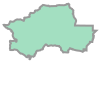

In [6]:
nagaokakyo

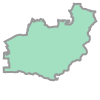

In [7]:
uji

面積を取得

In [8]:
uji.area

0.006660966971242728

座標の最小値、最大値を取得

In [9]:
uji.bounds

(135.75964610888104, 34.85791972101845, 135.879924449354, 34.957366667437896)

中央の位置を取得

In [10]:
uji.centroid.xy

(array('d', [135.82038762280726]), array('d', [34.90296543114109]))

距離を算出

In [11]:
uji.distance(nagaokakyo)

0.04672875626886362

## 地価公示データの可視化

国土交通省のGISホームページから、京都府の地価公示データを取得

> https://nlftp.mlit.go.jp/ksj/old/datalist/old_KsjTmplt-L01.html

In [12]:
kyoto_land_price = pd.read_csv("L01-2022P-26-01.0a/L01-2022P-2K_26.csv", encoding="cp932").dropna()
kyoto_land_price.loc[:, ["経度", "緯度"]] = kyoto_land_price.loc[:, ["経度", "緯度"]] / 3600
kyoto_land_price.head()

,経度,緯度,所在地コード,用途,連番,年次,前年所在地コード,前年用途,前年連番,市区町村名,...,属性移動Ｈ２５,属性移動Ｈ２６,属性移動Ｈ２７,属性移動Ｈ２８,属性移動Ｈ２９,属性移動Ｈ３０,属性移動Ｈ３１,属性移動Ｒ２,属性移動Ｒ３,属性移動Ｒ４
0,135.750710,35.043688,26101,0,1,2022,26101,0,1,京都北,...,10000000000000,10000000000000,10000000000000,10000000000000,10000000000000,10000000000000,10000000000000,10000000000000,10000000000000,10000000000000
1,135.755699,35.041793,26101,0,2,2022,26101,0,2,京都北,...,10000000000000,10000000000000,10000000000000,10000000000000,10000000000000,10000000000000,10000000000000,10000000000000,10000000000000,10000000000000
2,135.740909,35.072445,26101,0,3,2022,26101,0,3,京都北,...,10000000000000,10000010000000,10000000000000,10000000000000,10000000000000,10000000000000,10000000000000,10000000000000,10000000000000,10000000000000
3,135.733356,35.041629,26101,0,4,2022,26101,0,4,京都北,...,10000000000000,10000000000000,10000000000000,10000000000000,10000000000000,10000000000000,10000000000000,10000000000000,10000000000000,10000000000000
4,135.760057,35.041062,26101,0,5,2022,26101,0,5,京都北,...,10000000000000,10000000000000,10000000000000,10000000000000,10000000000000,10000000000000,10000000000000,10000000000000,10000000000000,10000000000000


2022年（令和4年）の価格を取得

In [13]:
kyoto_land_price_2022 = kyoto_land_price.groupby("市区町村名")["Ｒ４価格"].sum()
kyoto_land_price_2022.index = kyoto_land_price_2022.index.str.replace("京都", "")
kyoto_land_price_2022.head()

市区町村名
与謝野      75500
久御山     597000
亀岡     1589293
井手      104100
京丹後     124700
Name: Ｒ４価格, dtype: int64

GeoDataFrameに価格データを挿入

In [14]:
def remove_suffix(municipalities):
    for suffix in ("区", "市", "町", "村"):
        if municipalities[-1] == suffix:
            return municipalities.replace(suffix, "")


def get_land_price(municipalities):
    location = remove_suffix(municipalities)
    if location in kyoto_land_price_2022.index:
        return kyoto_land_price_2022.loc[location]

kyoto_gdf.loc[:, "2022価格"] = kyoto_gdf.loc[:, "N03_004"].map(get_land_price)
kyoto_gdf.head()

,N03_001,N03_002,N03_003,N03_004,N03_007,geometry,2022価格
N03_004,,,,,,,
北区,京都府,None,京都市,北区,26101,"POLYGON ((135.72539 35.17080, 135.72552 35.170...",9274000.0
上京区,京都府,None,京都市,上京区,26102,"POLYGON ((135.75062 35.03822, 135.75079 35.038...",7176000.0
左京区,京都府,None,京都市,左京区,26103,"POLYGON ((135.80481 35.31708, 135.80586 35.316...",13267700.0
中京区,京都府,None,京都市,中京区,26104,"POLYGON ((135.73195 35.02251, 135.73195 35.022...",34086000.0
東山区,京都府,None,京都市,東山区,26105,"POLYGON ((135.78466 35.01035, 135.78468 35.009...",14559000.0


In [15]:
bounds = kyoto_gdf.loc[:, "geometry"].bounds
center = {}
center["lon"] = np.mean((bounds.loc[:, "minx"].min(), bounds.loc[:, "maxx"].max()))
center["lat"] = np.mean((bounds.loc[:, "miny"].min(), bounds.loc[:, "maxy"].max()))
center

{'lon': 135.4546015306363, 'lat': 35.242505932552916}

コロプレスマップに可視化

In [16]:
px.choropleth_mapbox(
    kyoto_gdf,
    geojson=kyoto_gdf,
    locations="N03_004",
    color="2022価格",
    hover_name="N03_004",
    featureidkey="properties.N03_004",
    mapbox_style="carto-positron",
    zoom=8,
    center=center,
    opacity=0.5,
    width=800,
    height=800,
).show()

整然データに変換

In [17]:
kyoto_land_price = kyoto_land_price.iloc[
    :, : kyoto_land_price.columns.get_loc("属性移動Ｓ５９")
]
columns = list(kyoto_land_price.columns)
columns[
    kyoto_land_price.columns.get_loc(
        "Ｓ５８価格"
    ) : kyoto_land_price.columns.get_loc("Ｒ４価格")
    + 1
] = list(range(1983, 2023))
kyoto_land_price.columns = columns
kyoto_land_price = pd.melt(
    kyoto_land_price,
    id_vars=kyoto_land_price.columns[: kyoto_land_price.columns.get_loc(1983)],
    value_vars=list(range(1983, 2023)),
    var_name="年度",
    value_name="価格",
)
kyoto_land_price.loc[:, ["経度", "緯度", "年度", "価格"]]

,経度,緯度,年度,価格
0,135.750710,35.043688,1983,0
1,135.755699,35.041793,1983,0
2,135.740909,35.072445,1983,0
3,135.733356,35.041629,1983,0
4,135.760057,35.041062,1983,325000
...,...,...,...,...
25275,135.425795,35.158596,2022,25900
25276,135.428447,35.212466,2022,6450
25277,135.150351,35.563658,2022,26000
25278,135.154648,35.568260,2022,20500


散布図をアニメーション描画

In [18]:
px.scatter_mapbox(
    kyoto_land_price,
    lat="緯度",
    lon="経度",
    size="価格",
    color="用途区分",
    hover_name="市区町村名",
    hover_data=["所在並びに地番"],
    animation_frame="年度",
    center=center,
    opacity=0.5,
    width=800,
    height=800,
    zoom=8,
    mapbox_style="carto-positron",
).show()

ダウンロードしたファイルを削除

In [19]:
!rm -rf *.zip *dbf *.geojson *.prj *.shp *.xml *.shx L01-2022P-26-01.0a